In [1]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

## Importing Data

In [2]:
# raw_data directory
raw_data_path = "../Data/raw_data"
# Initialize an empty list to store DataFrames
df_list = []

# Use os.walk to traverse the directory and find all CSV files
for root, dirs, files in os.walk(raw_data_path):
    for file in files:
        if file.endswith(".csv"):
            print(f"Found file: {file}")  # Confirm files are found
            # Get the full file path
            file_path = os.path.join(root, file)
            # Read the CSV file into a DataFrame and add it to the list
            df_list.append(pd.read_csv(file_path))



# Check if df_list is empty before concatenating
if df_list:
    # Concatenate all DataFrames into one
    combined_df = pd.concat(df_list, ignore_index=True)
    print("All CSV files have been successfully read into a single DataFrame.")
else:
    print("No CSV files found in the directory.")

# display the first few rows of the combined DataFrame
combined_df.head()


Found file: 2023-01-cleveland-street.csv
Found file: 2023-02-cleveland-street.csv
Found file: 2023-03-cleveland-street.csv
Found file: 2023-04-cleveland-street.csv
Found file: 2023-05-cleveland-street.csv
Found file: 2023-06-cleveland-street.csv
Found file: 2023-07-cleveland-street.csv
Found file: 2023-08-cleveland-street.csv
Found file: 2023-09-cleveland-street.csv
Found file: 2023-10-cleveland-street.csv
Found file: 2023-11-cleveland-street.csv
Found file: 2023-12-cleveland-street.csv
Found file: 2024-01-cleveland-street.csv
Found file: 2024-02-cleveland-street.csv
Found file: 2024-03-cleveland-street.csv
Found file: 2024-04-cleveland-street.csv
Found file: 2024-05-cleveland-street.csv
Found file: 2024-06-cleveland-street.csv
All CSV files have been successfully read into a single DataFrame.


,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,a4c83212c5e08e368dc841371fc26a62f7a476d19dd836...,2023-01,Cleveland Police,Cleveland Police,-1.212283,54.506084,On or near Bromley Lane,E01027626,Hambleton 002D,Other theft,Investigation complete; no suspect identified,NaN
1,NaN,2023-01,Cleveland Police,Cleveland Police,-1.235660,54.710526,On or near Dobson Place,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
2,NaN,2023-01,Cleveland Police,Cleveland Police,-1.237805,54.711196,On or near King Oswy Shops,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
3,NaN,2023-01,Cleveland Police,Cleveland Police,-1.236325,54.713146,On or near Lazenby Road,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
4,c108d52a0f5bb4dd8e7f50ad9bd75e583a0a0d2ab1d1ee...,2023-01,Cleveland Police,Cleveland Police,-1.239865,54.710589,On or near Marshall Close,E01011954,Hartlepool 001A,Burglary,Investigation complete; no suspect identified,NaN


In [3]:
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 142284 entries, 0 to 142283
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Crime ID               116539 non-null  object 
 1   Month                  142284 non-null  object 
 2   Reported by            142284 non-null  object 
 3   Falls within           142284 non-null  object 
 4   Longitude              142284 non-null  float64
 5   Latitude               142284 non-null  float64
 6   Location               142284 non-null  object 
 7   LSOA code              142284 non-null  object 
 8   LSOA name              142284 non-null  object 
 9   Crime type             142284 non-null  object 
 10  Last outcome category  116539 non-null  object 
 11  Context                0 non-null       float64
dtypes: float64(3), object(9)
memory usage: 13.0+ MB


* The month column data type would be changed to datetime
* Context column would be dropped

In [4]:
combined_df.describe()

,Longitude,Latitude,Context
count,142284.000000,142284.000000,0.0
mean,-1.220911,54.586892,NaN
std,0.091619,0.050365,NaN
min,-1.436189,54.472215,NaN
25%,-1.289756,54.555941,NaN
50%,-1.230299,54.570602,NaN
75%,-1.191889,54.606144,NaN
max,-0.792048,54.732026,NaN


In [5]:
combined_df.shape

(142284, 12)

In [6]:
combined_df.head(5)

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,a4c83212c5e08e368dc841371fc26a62f7a476d19dd836...,2023-01,Cleveland Police,Cleveland Police,-1.212283,54.506084,On or near Bromley Lane,E01027626,Hambleton 002D,Other theft,Investigation complete; no suspect identified,NaN
1,NaN,2023-01,Cleveland Police,Cleveland Police,-1.235660,54.710526,On or near Dobson Place,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
2,NaN,2023-01,Cleveland Police,Cleveland Police,-1.237805,54.711196,On or near King Oswy Shops,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
3,NaN,2023-01,Cleveland Police,Cleveland Police,-1.236325,54.713146,On or near Lazenby Road,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
4,c108d52a0f5bb4dd8e7f50ad9bd75e583a0a0d2ab1d1ee...,2023-01,Cleveland Police,Cleveland Police,-1.239865,54.710589,On or near Marshall Close,E01011954,Hartlepool 001A,Burglary,Investigation complete; no suspect identified,NaN


In [7]:
combined_df[["Reported by", "Falls within"]].value_counts()

Reported by       Falls within    
Cleveland Police  Cleveland Police    142284
dtype: int64

* Drop "Reported by" column because it has the same value as "Falls within"

In [8]:
combined_df["Crime ID"].duplicated().sum()

25745

* The value count of the duplicated cells is the same as the null value count, which indicates that the data has no duplicates 

#### checking the unique counts of the crime type column.


In [9]:
combined_df["Crime type"].value_counts()

Violence and sexual offences    47065
Anti-social behaviour           25745
Criminal damage and arson       14347
Shoplifting                     11822
Public order                    10834
Other theft                      7851
Burglary                         6962
Vehicle crime                    6691
Drugs                            3823
Other crime                      3271
Robbery                          1262
Possession of weapons            1096
Bicycle theft                     936
Theft from the person             579
Name: Crime type, dtype: int64

#### checking the unique counts of the Last outcome category column.


In [10]:
combined_df["Last outcome category"].value_counts()

Unable to prosecute suspect                            50891
Investigation complete; no suspect identified          45560
Court result unavailable                                5235
Under investigation                                     4659
Awaiting court outcome                                  4615
Status update unavailable                               1913
Further action is not in the public interest             791
Action to be taken by another organisation               728
Further investigation is not in the public interest      664
Formal action is not in the public interest              625
Offender given a caution                                 359
Offender given a drugs possession warning                258
Local resolution                                         189
Offender given penalty notice                             29
Suspect charged as part of another case                   23
Name: Last outcome category, dtype: int64

#### Checking for Null values 

In [11]:
combined_df.isnull().sum()

Crime ID                  25745
Month                         0
Reported by                   0
Falls within                  0
Longitude                     0
Latitude                      0
Location                      0
LSOA code                     0
LSOA name                     0
Crime type                    0
Last outcome category     25745
Context                  142284
dtype: int64

##### * The null values in the crime ID column and Last outcome category column are the same. 
##### * The Context colunm doesnt have any value, its all Null. Delete?

##### Filtering through the df to identify relationship between CrimeID and Null values. 

In [12]:
checking_null= combined_df[combined_df["Crime ID"].isnull()]
checking_null

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
1,NaN,2023-01,Cleveland Police,Cleveland Police,-1.235660,54.710526,On or near Dobson Place,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
2,NaN,2023-01,Cleveland Police,Cleveland Police,-1.237805,54.711196,On or near King Oswy Shops,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
3,NaN,2023-01,Cleveland Police,Cleveland Police,-1.236325,54.713146,On or near Lazenby Road,E01011954,Hartlepool 001A,Anti-social behaviour,NaN,NaN
19,NaN,2023-01,Cleveland Police,Cleveland Police,-1.251890,54.711643,On or near Westwood Way,E01011971,Hartlepool 001D,Anti-social behaviour,NaN,NaN
24,NaN,2023-01,Cleveland Police,Cleveland Police,-1.244546,54.711795,On or near Rafton Drive,E01033465,Hartlepool 001F,Anti-social behaviour,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
142261,NaN,2024-06,Cleveland Police,Cleveland Police,-1.317364,54.528175,On or near Brough Field Close,E01033475,Stockton-on-Tees 028A,Anti-social behaviour,NaN,NaN
142265,NaN,2024-06,Cleveland Police,Cleveland Police,-1.327886,54.518788,On or near Glyder Court,E01035204,Stockton-on-Tees 028B,Anti-social behaviour,NaN,NaN
142270,NaN,2024-06,Cleveland Police,Cleveland Police,-1.330211,54.514541,On or near Newgale Close,E01012231,Stockton-on-Tees 028C,Anti-social behaviour,NaN,NaN
142271,NaN,2024-06,Cleveland Police,Cleveland Police,-1.323492,54.512617,On or near Owls Grove,E01012231,Stockton-on-Tees 028C,Anti-social behaviour,NaN,NaN


In [13]:
checking_null['Crime type'].value_counts()

Anti-social behaviour    25745
Name: Crime type, dtype: int64

* The null values in the crimeID and LastOutcomeCategory are correllated with the AntiSocial Behaviour Column.
* Antisocial Behaviour has no crimeId and doesnt have a last outcome.
* The Nan value in LAstOutcomeCategory will be filled with "statusUnknown"

## Implementing the data transformations.

In [14]:
# Drop the "Crime ID", "Context" and "Reported by" columns
combined_df.drop(['Crime ID','Context', 'Reported by'], axis=1, inplace=True)


# Change "Month" column to datetime datatype
combined_df['Month'] = pd.to_datetime(combined_df['Month'])


# Set the "Month" column as index
combined_df.set_index('Month', inplace=True)


# Fill the NaN in the "Last Outcome category" column with "statusUnknown"
combined_df['Last outcome category'] = combined_df['Last outcome category'].fillna('statusUnknown')


# Print the transformed data
combined_df.head()


,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category
Month,,,,,,,,
2023-01-01,Cleveland Police,-1.212283,54.506084,On or near Bromley Lane,E01027626,Hambleton 002D,Other theft,Investigation complete; no suspect identified
2023-01-01,Cleveland Police,-1.235660,54.710526,On or near Dobson Place,E01011954,Hartlepool 001A,Anti-social behaviour,statusUnknown
2023-01-01,Cleveland Police,-1.237805,54.711196,On or near King Oswy Shops,E01011954,Hartlepool 001A,Anti-social behaviour,statusUnknown
2023-01-01,Cleveland Police,-1.236325,54.713146,On or near Lazenby Road,E01011954,Hartlepool 001A,Anti-social behaviour,statusUnknown
2023-01-01,Cleveland Police,-1.239865,54.710589,On or near Marshall Close,E01011954,Hartlepool 001A,Burglary,Investigation complete; no suspect identified


# Data Visualizations
* Univariate Analysis

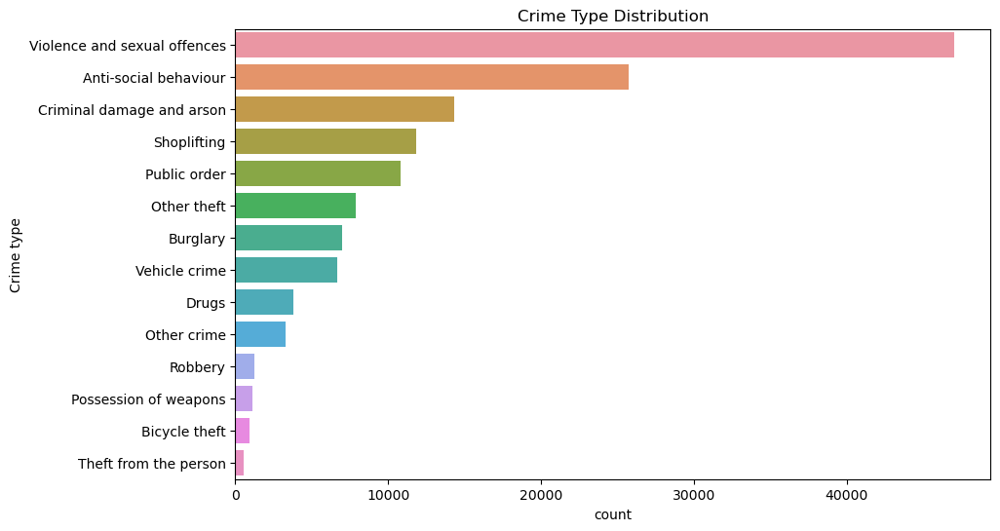

In [15]:
# Crime Types Distribution
plt.figure(figsize=(10,6))
sns.countplot(data=combined_df, y='Crime type', order=combined_df['Crime type'].value_counts().index)
plt.title('Crime Type Distribution')
plt.show()

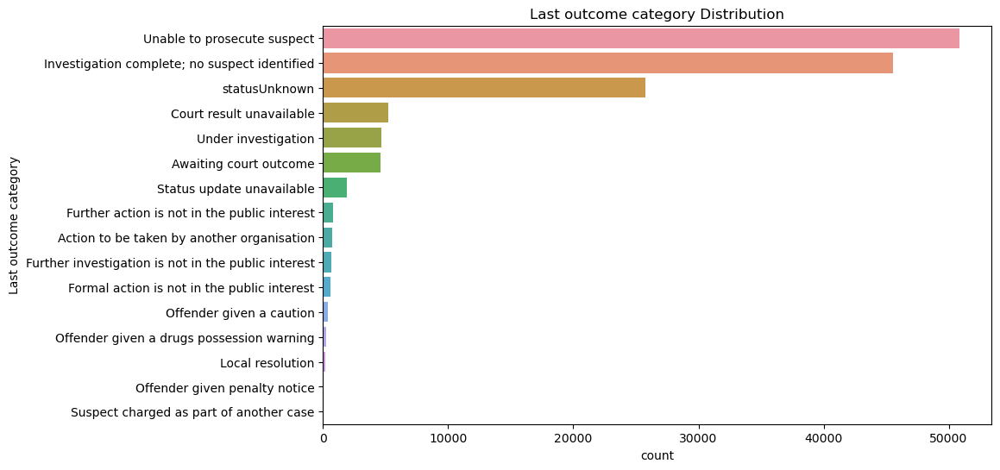

In [16]:
# Last outcome category Distribution
plt.figure(figsize=(10,6))
sns.countplot(data=combined_df, y='Last outcome category', order=combined_df['Last outcome category'].value_counts().index)
plt.title('Last outcome category Distribution')
plt.show()

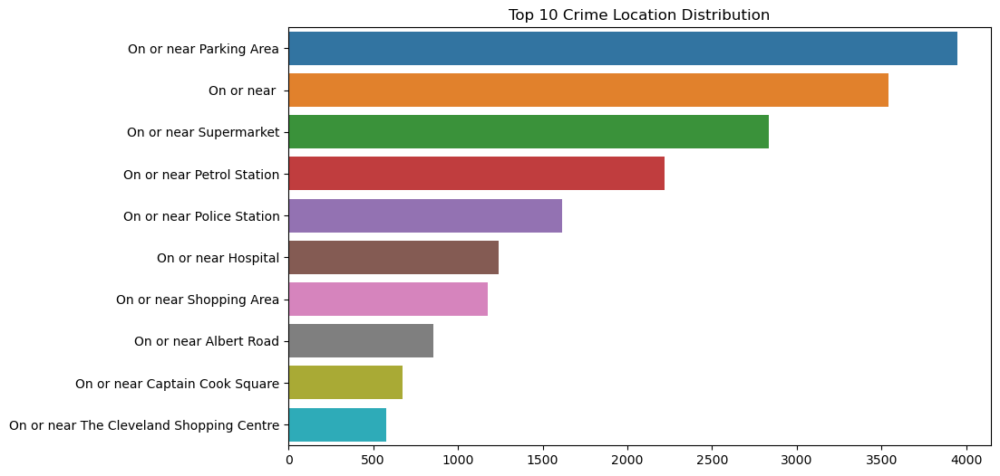

In [17]:
# Last outcome category Distribution

# Get the top 10 loactions
top_10_locations = combined_df['Location'].value_counts().nlargest(10)

# Plot the locations
plt.figure(figsize=(10,6))
sns.barplot(x=top_10_locations.values, y=top_10_locations.index)
plt.title('Top 10 Crime Location Distribution')
plt.show()

* Multivariate Analysis

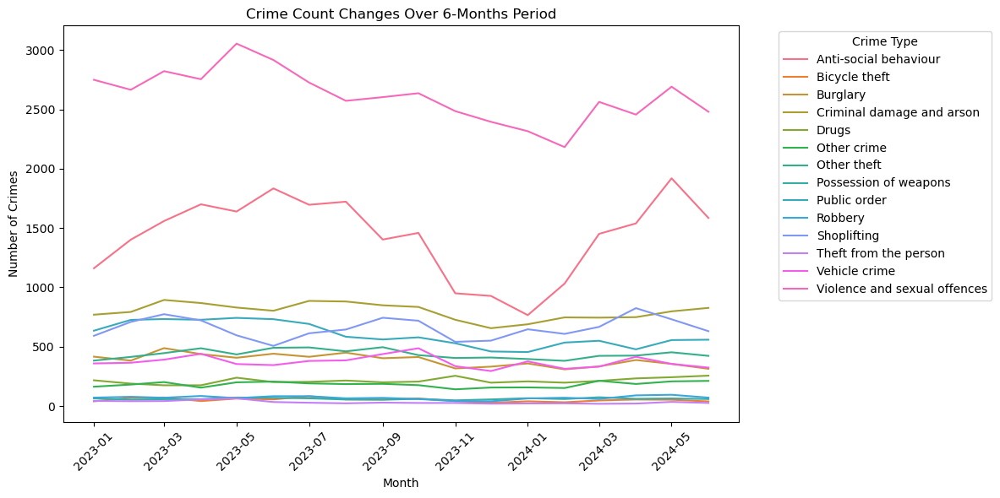

In [18]:
# Crime Trends

crime_counts = combined_df.groupby(['Month', 'Crime type']).size().reset_index(name='Counts')

plt.figure(figsize=(12, 6))
sns.lineplot(x='Month', y='Counts', hue='Crime type', data=crime_counts)

plt.title('Crime Count Changes Over 6-Months Period')
plt.xticks(rotation=45)
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.legend(title='Crime Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [19]:
# Plotting Crime Occurence Map

import plotly.graph_objects as go
# Create the trace
trace = go.Scattermapbox(
    lat=combined_df['Latitude'],
    lon=combined_df['Longitude'],
    mode='markers',
    marker=dict(size=20),
    text=combined_df['Location'] if 'Location' in combined_df.columns else None,  # Optional: add city names as hover text
    hoverinfo='text'
)

# Set up the layout
layout = go.Layout(
    mapbox=dict(
        style="open-street-map",
        center=dict(lat=combined_df['Latitude'].mean(), lon=combined_df['Longitude'].mean()),
        zoom=3
    ),
    showlegend=False
)

# Create and show the figure
fig = go.Figure(data=[trace], layout=layout)
fig.show()

# Save the figure as an HTML file
fig.write_html("map.html")

In [20]:
# Plotting Crime Occurence Map

import plotly.graph_objects as go
# Create the trace
trace = go.Scattermapbox(
    lat=combined_df['Latitude'],
    lon=combined_df['Longitude'],
    mode='markers',
    marker=dict(size=20),
    text=combined_df['Crime type'] if 'Crime type' in combined_df.columns else None,  # Optional: add city names as hover text
    hoverinfo='text'
)

# Set up the layout
layout = go.Layout(
    mapbox=dict(
        style="open-street-map",
        center=dict(lat=combined_df['Latitude'].mean(), lon=combined_df['Longitude'].mean()),
        zoom=3
    ),
    showlegend=False
)

# Create and show the figure
fig = go.Figure(data=[trace], layout=layout)
fig.show()

# Save the figure as an HTML file
fig.write_html("map2.html")

# Saving Processed data as csv

In [24]:
file_path = r'C:\Users\USER\Documents\GitHub\cleveland-pd-crime-project\Data\raw_data\Processed Data\clean_df.csv'
combined_df.to_csv(file_path, index=True)